In [1]:
import os
import random
import spacy
import ast
import glob
import spacy
import openai
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx
import hdbscan
import module

from collections import defaultdict
from itertools import combinations
from matplotlib.colors import ListedColormap
from tqdm.auto import tqdm
from langdetect import detect, DetectorFactory
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.stats import gaussian_kde



# Input

In [2]:
user_path = 'exp/arrangement_weighed.csv'
df = pd.read_csv(user_path)

# Correctly read the lists and dictionaries
df = module.eval_as(df)


In [3]:
# Full bvb export for metadata
path = '../../data/hertziana_exp/b3kat_export/'
files = glob.glob(os.path.join(path, '*.csv'))

li = []

for filename in files: 
    frame = pd.read_csv(filename, header=0, encoding='utf-8', encoding_errors='replace')
    li.append(frame)

df_full = pd.concat(li, axis=0, ignore_index=True)

df_full= df_full[['id', 'lang', 'authors', 'parentId', 'title', 'subtitle', 'statement']] # Select columns here
df_full = df_full.drop_duplicates(subset=['id'])

df = df.merge(df_full, left_on='title', right_on='title', how='left')
df = df.drop_duplicates(subset=['Z30_CALL_NO'])

/var/folders/fs/xb9k_3m95gq0wjgk1kgw1nxr0000gn/T/ipykernel_6210/3286076840.py:8: DtypeWarning: Columns (12,13) have mixed types. Specify dtype option on import or set low_memory=False.
  frame = pd.read_csv(filename, header=0, encoding='utf-8', encoding_errors='replace')


# Subjects

### Get Subject from Call Number 

In [7]:
df['Subject'] = df['Z30_CALL_NO'].apply(lambda x: module.get_subject(str(x)))

### Plot Subjects over the Mapping

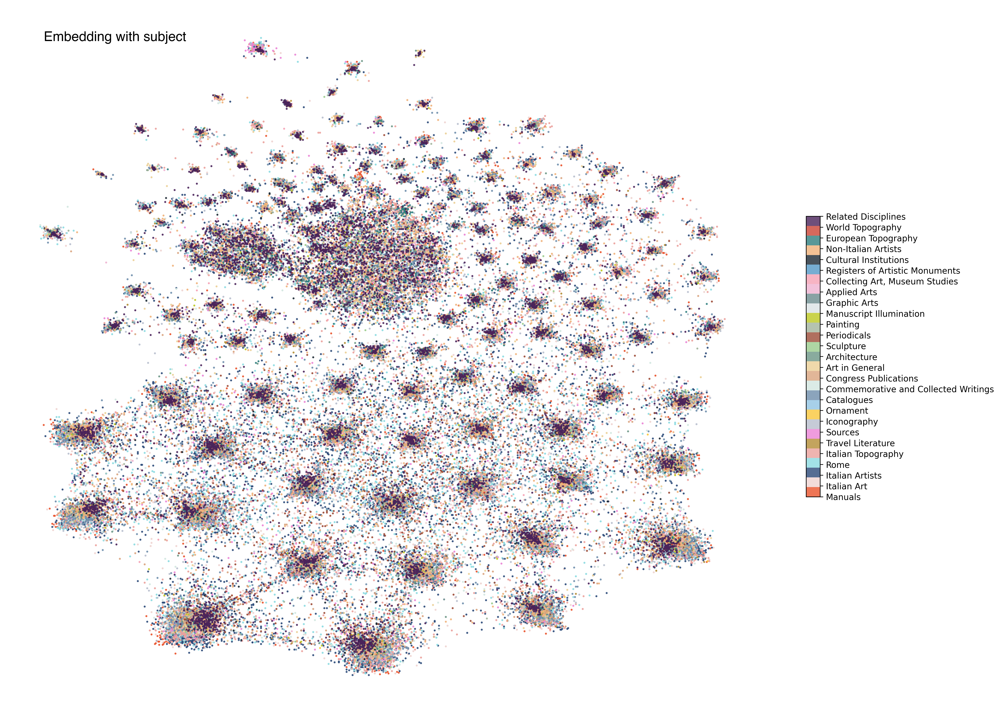

In [8]:
# Create a mapping from labels to color indices
label_to_color_index = {label: idx for idx, label in enumerate(module.SUBJECT_DICT.values())}

# Map labels to color indices
color_indices = np.array([label_to_color_index[label] for label in df.Subject])

plt.figure(figsize=(20, 15), dpi=300)
plt.axis("off")
scatter = plt.scatter(
    df["x"].to_list(),
    df["y"].to_list(),
    s=2,
    c=color_indices, 
    cmap=module.CUSTOM_CMAP, 
    alpha=0.8
)
# Add title in the top left corner
title_text = 'Embedding with subject'
plt.text(0.05, 0.95, title_text, transform=plt.gca().transAxes, fontsize=16, ha='left', fontname='Helvetica')
cbar = plt.colorbar(scatter, shrink=0.4)
cbar.set_ticks([label_to_color_index[label] for label in module.SUBJECT_DICT.values()])
cbar.set_ticklabels(list(module.SUBJECT_DICT.values()))
plt.show()

/Users/hana/Documents/GitHub/BHVizData/thesis/src/module.py:147: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(x_values, y_values, s=2, c=color)


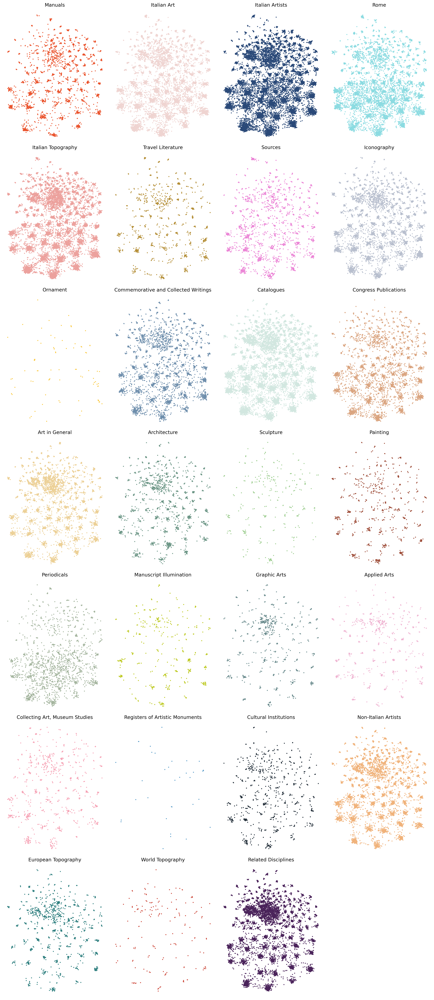

In [9]:
module.small_multiple_subject(df)

# Languages

### Language Detection 

In [25]:
# !python -m spacy download it_core_news_sm
# !python -m spacy download en_core_web_sm
# !python -m spacy download de_core_news_sm
# !python -m spacy download fr_core_news_sm
# !python -m spacy download es_core_news_sm
# !python -m spacy download nl_core_news_sm

In [10]:
tqdm.pandas(desc="language detection")

# Language detection 
DetectorFactory.seed = 42

lang_code_mapping = {
    'en': 'eng',  # English
    'it': 'ita',  # Italian
    'de': 'ger',  # German
    'fr': 'fre',  # French
    'es': 'spa',  # Spanish
    'nl': 'dut'   # Dutch
}

def detect_language(title):
    try:
        return detect(title)
    except:
        return None

df.loc[df['lang'].isna(), 'lang'] = df[df['lang'].isna()]['title'].progress_apply(lambda x : lang_code_mapping.get(detect_language(x)))

language detection:   0%|          | 0/7613 [00:00<?, ?it/s]

### Title Tokenisation and stop word removal 

In [11]:
tqdm.pandas(desc="title tokenization")

top_langs = ['ita', 'eng', 'ger', 'fre', 'spa', 'dut'] # und is undefined and thus dropped from the list, latin doesn't exist in spacy

# These languages exist both as spacy models and in our dataset
lang_to_spacy_model = {
    'ita': 'it_core_news_sm',
    'eng': 'en_core_web_sm',
    'ger': 'de_core_news_sm',
    'fre': 'fr_core_news_sm',
    'spa': 'es_core_news_sm',
    'dut': 'nl_core_news_sm'
}

# Load spacy models
nlp_models = {lang: spacy.load(model_name) for lang, model_name in lang_to_spacy_model.items()}

# Preprocess the titles
def tokenize_and_remove_stop_words(title, lang):
    if lang in nlp_models:
        doc = nlp_models[lang](title)
        tokens = [token.text for token in doc if not token.is_stop and not token.is_punct]
        return tokens
    else:
        return None

# Tokenize titles and remove stopwords
df['title_tok'] = df.progress_apply(lambda row: tokenize_and_remove_stop_words(str(row['title']) + str(row['subtitle']), row['lang']), axis=1)
df['title_tok'] = df['title_tok'].apply(lambda x: x if isinstance(x, list) else [])




title tokenization:   0%|          | 0/95086 [00:00<?, ?it/s]

### Plot Languages over the mapping

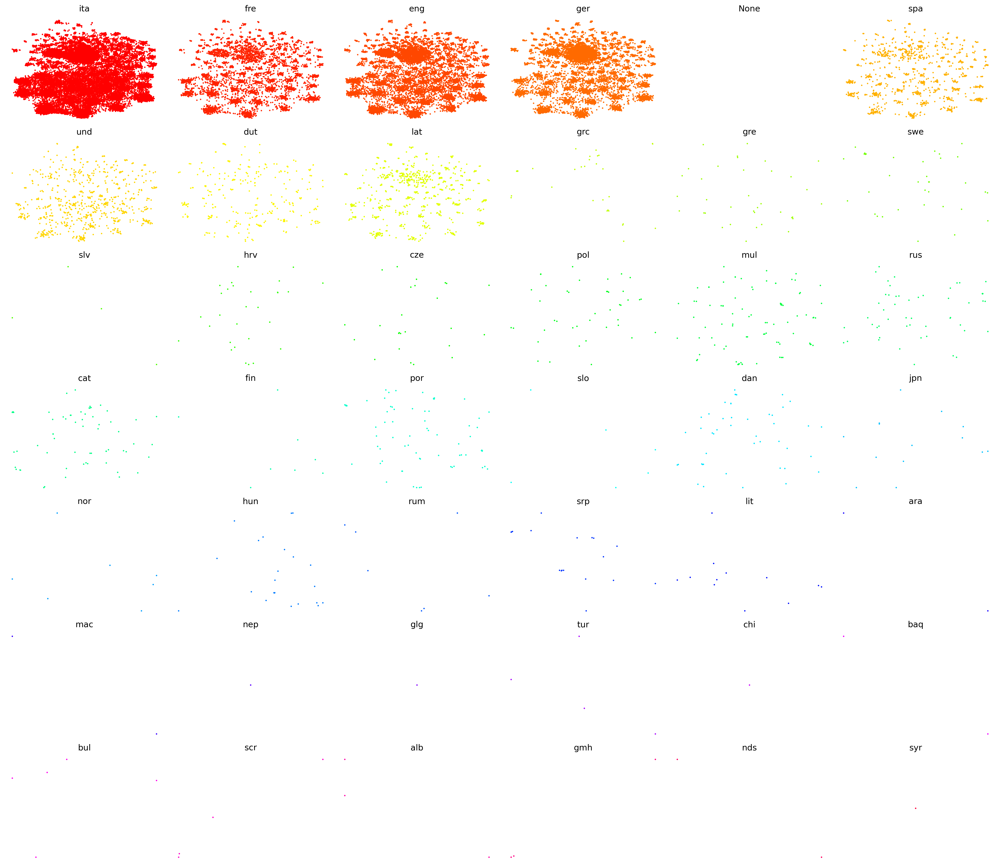

In [12]:
unique_langs = df['lang'].unique()
n_langs = len(unique_langs)

num_cols = 6
num_rows = (n_langs - 1) // num_cols + 1

fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 20), dpi=300)

for i, lang in enumerate(unique_langs):
    row, col = i // num_cols, i % num_cols
    ax = axes[row, col]
    ax.set_title(f'{lang}')

    rows = df[df.lang == lang]

    x_values = rows['x'].to_list()
    y_values = rows['y'].to_list()

    color = plt.cm.hsv(i / n_langs)
    ax.scatter(x_values, y_values, s=1, c=[color])
    ax.axis("off")

for i in range(n_langs, num_rows * num_cols):
    row, col = i // num_cols, i % num_cols
    axes[row, col].set_visible(False)

plt.tight_layout()
plt.subplots_adjust(top=0.85)

plt.show()


# Cluster analysis

### Exclude books not assigned to a cluster

In [14]:
clusters = df[df['cluster'] != -1]
clusters.sample()

,Z30_CALL_NO,frequency,users,users_weighed,yearly_frequency,yearly_loan_time,title,is_outlier,yearly_frequency_norm,frequency_norm,...,y,cluster,id,lang,authors,parentId,subtitle,statement,Subject,title_tok
558369,Wa-HIT 90-6130,1,[E-411],[E-411],{2015: 1},{2015: 1.0},Die Alben von Jakob Ignaz Hittorff: das Album ...,False,"{2016: 0.0, 2021: 0.0, 2018: 0.0, 2023: 0.0, 2...",0.0,...,582,18,NaN,ger,NaN,NaN,NaN,NaN,Non-Italian Artists,"[Alben, Jakob, Ignaz, Hittorff, Album, Sicile,..."


### Number of users per cluster

Gives insight into how well the clustering groups around specialised fields of research

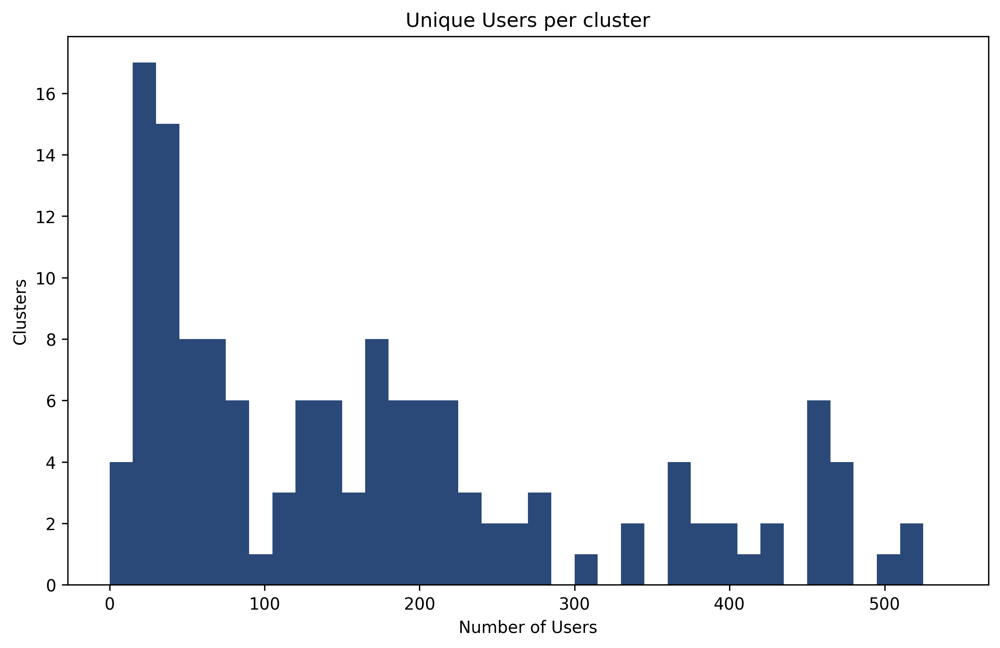

In [30]:
users_per_cluster = clusters.groupby('cluster').users.apply(lambda x: len(set().union(*x)))
plt.figure(figsize=(10, 6), dpi=300)
bins = np.arange(0, users_per_cluster.max()+ 1, 15)
plt.hist(users_per_cluster, bins=bins, color='#2A4978')
plt.title('Unique Users per cluster')
plt.xlabel('Number of Users')
plt.ylabel('Clusters')


plt.show()

# Heatmaps Subject, Language, Time

Evaluate how well the clustering is working

### Percentage of each Subject in the clusters


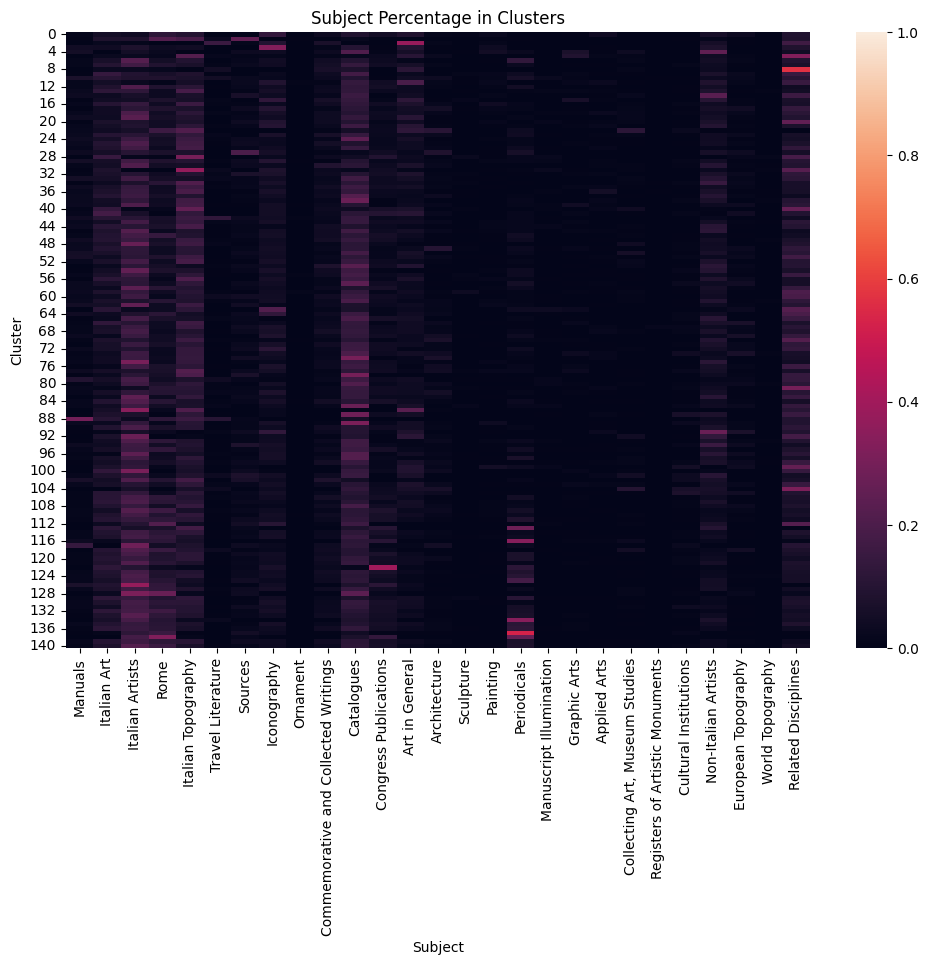

In [16]:
# Subject in percentage by cluster and frequency
module.subject_heatmap(clusters)

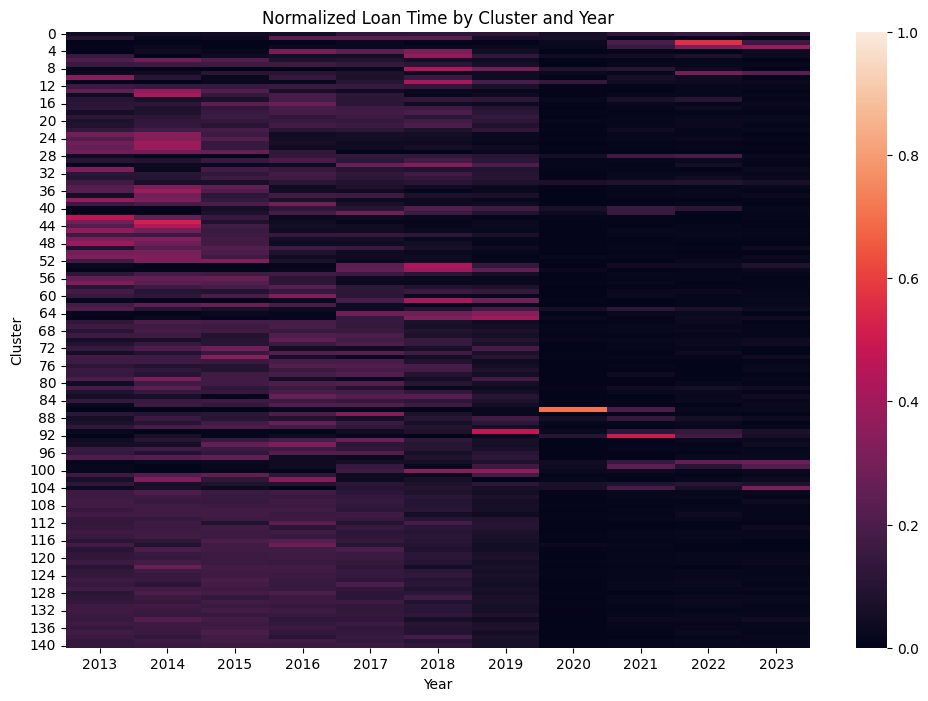

In [18]:
# Temporality Heatmap
module.temporality_heatmap(clusters)

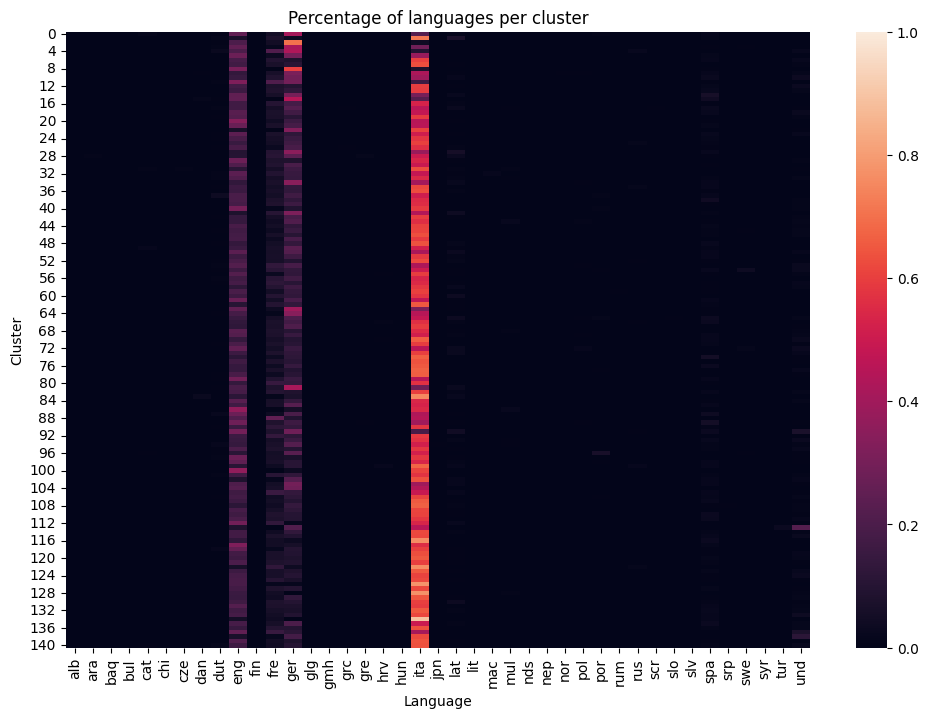

In [19]:
# Language Heatmap

module.language_heatmap(clusters)

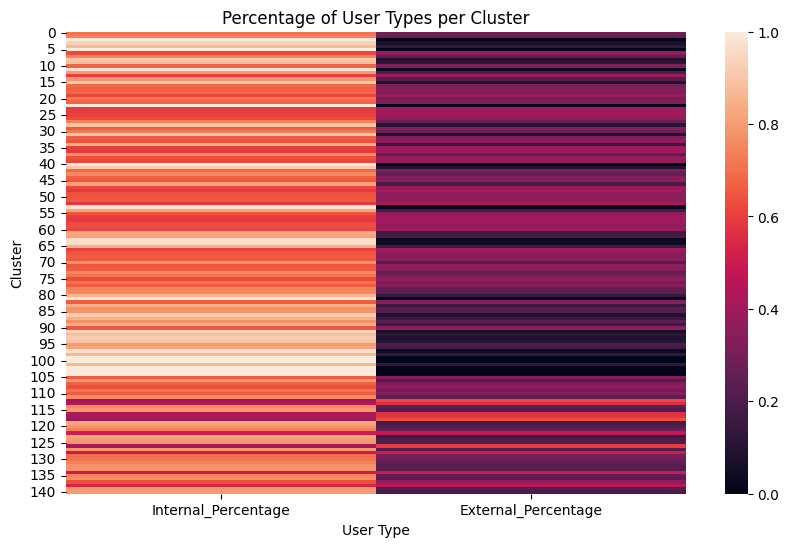

In [20]:
# User type Heatmap

def sum_user_type(user_list):
    users = [user for sublist in user_list for user in sublist]
    users = set(users)
    summed_times = {'Internal': 0, 'External': 0}
    for user in users:
        if user.startswith('I'):
            summed_times['Internal'] += 1
        else:
            summed_times['External'] += 1
    return summed_times


cluster_frequencies = clusters.groupby('cluster')['users'].apply(sum_user_type).reset_index()
cluster_frequencies = cluster_frequencies.pivot(index='cluster', columns='level_1', values='users')

cluster_frequencies['Total'] = cluster_frequencies['Internal'] + cluster_frequencies['External']

cluster_frequencies['Internal_Percentage'] = cluster_frequencies['Internal'] / cluster_frequencies['Total']
cluster_frequencies['External_Percentage'] = cluster_frequencies['External'] / cluster_frequencies['Total']


plt.figure(figsize=(10, 6))
sns.heatmap(cluster_frequencies[['Internal_Percentage', 'External_Percentage']])
plt.title("Percentage of User Types per Cluster")
plt.xlabel("User Type")
plt.ylabel("Cluster")
plt.show()

# Create Cluster Dataframe

In [21]:
cluster_numbers = []
cluster_xs = []
cluster_ys = []
cluster_users = []
cluster_size = []
cluster_books = []
cluster_titles = []

for cluster_number in np.unique(df.cluster.unique()):
    if cluster_number == -1:
        continue  # Skip outliers which are labelled as -1
     
    cluster_indices = np.where(df.cluster== cluster_number)[0]
    rows = df.iloc[cluster_indices]   
    cluster_x = rows['x'].mean()
    cluster_y = rows['y'].mean()
    users = rows['users'].explode().unique().tolist()
    size = len(users)
    titles = rows['title_tok'].apply(lambda x: ' '.join(x))
    books = len(rows)


    cluster_numbers.append(cluster_number)
    cluster_xs.append(cluster_x)
    cluster_ys.append(cluster_y)
    cluster_users.append(users)
    cluster_size.append(size)
    cluster_titles.append(titles)
    cluster_books.append(books)


clusters_df = pd.DataFrame({
    'cluster': cluster_numbers,
    'x': cluster_xs,
    'y': cluster_ys,
    'users': cluster_users, 
    'nr_users': cluster_size, 
    'nr_books': cluster_books,
    'titles_tokenized': cluster_titles
})

# Loan Density over the Mapping

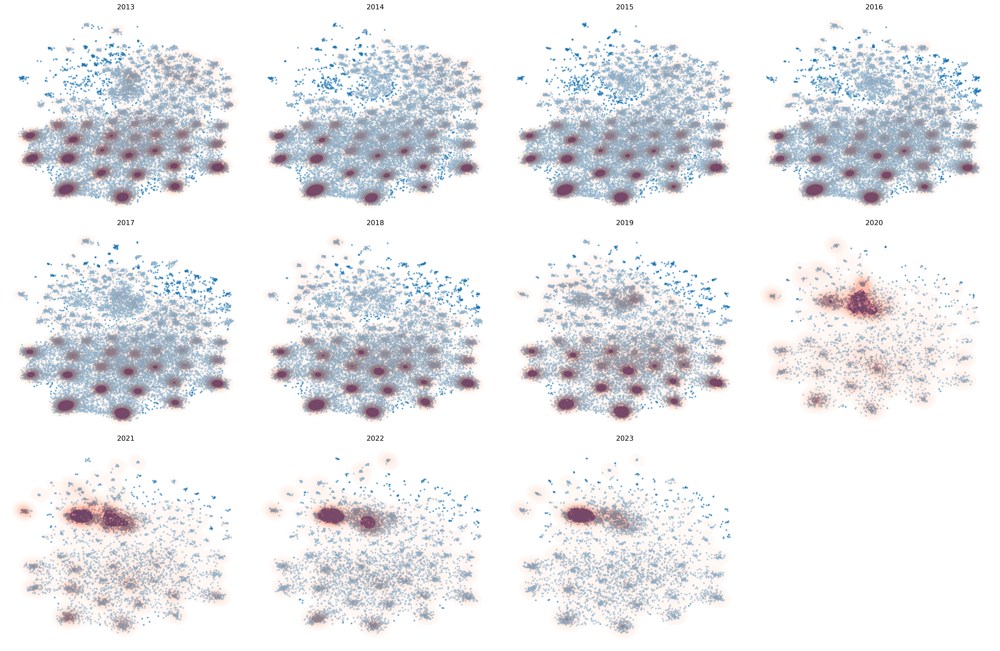

In [22]:
# Gaussian KDE on position (Where are there a lot of books per year)

unique_years = np.arange(2013, 2024)

num_rows = (len(unique_years) - 1) // 4 + 1 # subplots
fig, axes = plt.subplots(num_rows, 4, figsize=(24, 6 * num_rows), dpi=300)

for i, year in enumerate(unique_years):
    row, col = i // 4, i % 4
    ax = axes[row, col]
    ax.set_title(f'{year}')
    
    # Get books with non-zero frequency
    year_data = df[df['yearly_frequency_norm'].apply(lambda norm: norm.get(year, 0) > 0)]
    x_values = year_data['x'].tolist()
    y_values = year_data['y'].tolist()

    # xy = np.vstack([x_values, y_values])
    # z = gaussian_kde(xy)(xy)
    sc = ax.scatter(x_values, y_values, s=5 ,alpha = 0.5)
    sns.kdeplot(x=x_values, y=y_values, ax=ax, cmap='Reds', fill=True, alpha=0.5, bw_adjust=0.5)
    ax.axis("off")

# Hide empty subplots
for i in range(len(unique_years), num_rows * 4):
    row, col = i // 4, i % 4
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.subplots_adjust(top=0.85)

plt.show()

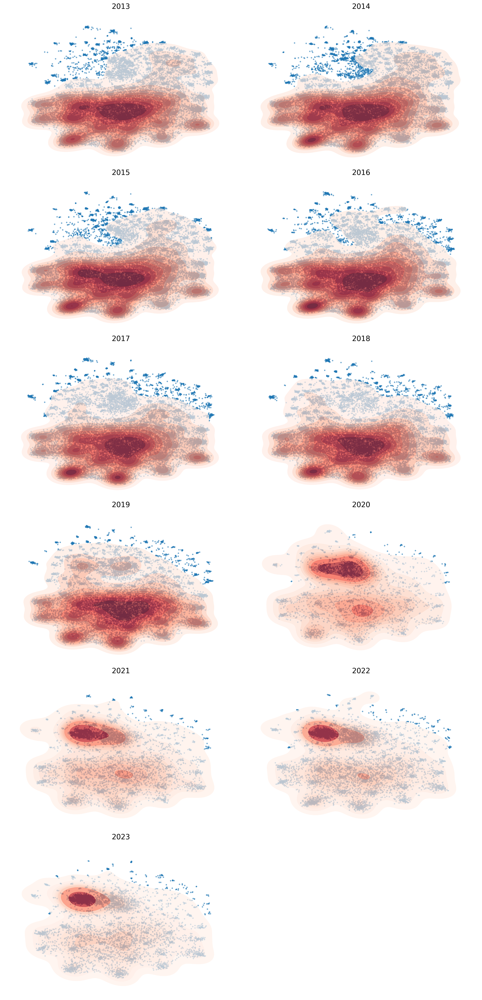

In [23]:
# Areas of high loan activity per year
module.plot_loan_density(df)

# Output clusters

In [65]:
# df.to_csv('exp/book_df.csv', index=False)
# clusters_df.to_csv('exp/clusters.csv', index=False)